# Importation des packages et données

In [1]:
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
import os
import math
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import random
import argparse
import matplotlib.animation as animation
import torch.nn.utils.spectral_norm as spectral_norm
from ignite.metrics import FID, InceptionScore
import PIL.Image as Image


from IPython.display import HTML

import torch.optim as optim


from ignite.engine import Engine, Events
import ignite.distributed as idist

In [2]:
# Set random seed for reproducibility
#manualSeed = 999
manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
#torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  2622


In [168]:
# Root directory for dataset
dataroot = "/Cat_9000/cats"
dataroot = "Cat_face"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 150

# Size of feature maps in generator
ngf = 196

# Size of feature maps in discriminator
ndf = 196

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

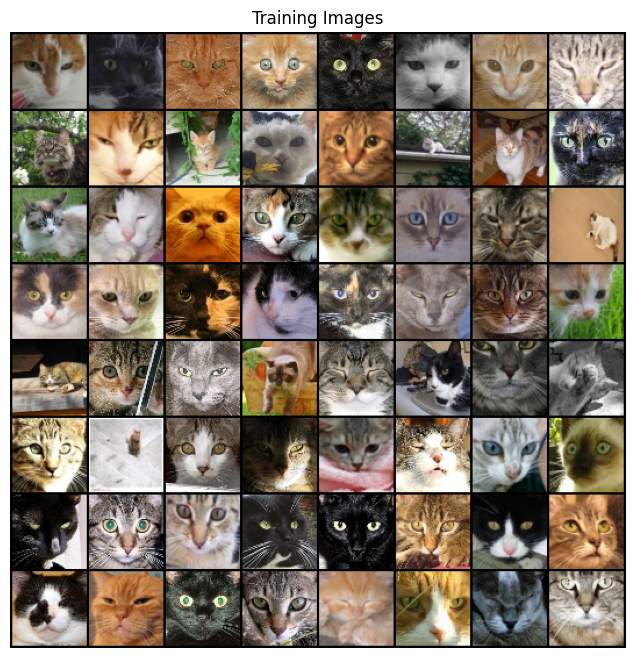

In [169]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

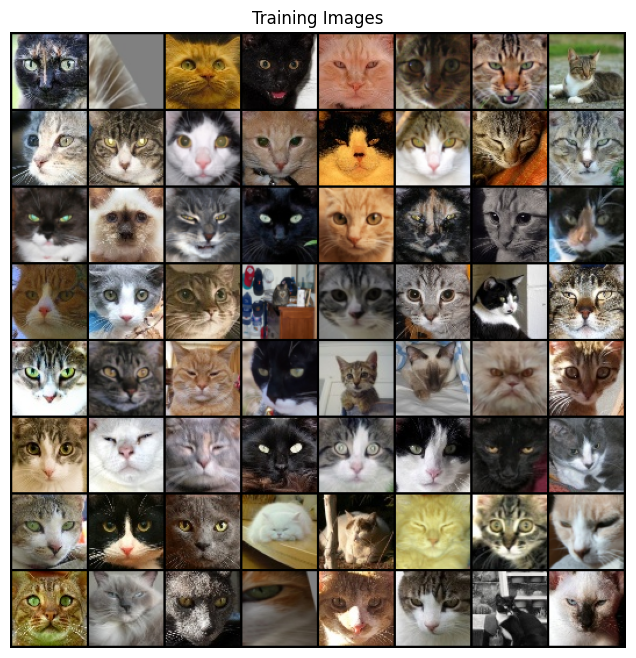

In [170]:
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torch.utils.data as data
import numpy as np

# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Calculate the number of images for training and testing
num_total = len(dataset)
num_test = 128  # Take only 128 images for testing
num_train = num_total - num_test  # Remaining images for training

# Split the dataset into training and testing subsets
train_dataset, test_dataset = data.random_split(dataset, [num_train, num_test])

# Create the data loaders
dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size,
                                               shuffle=True, num_workers=workers)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=num_test,
                                              shuffle=False, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))
plt.show()


# Création de l'architecture du modèle DCGAN

In [172]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [173]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [174]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(150, 1568, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1568, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1568, 784, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(784, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(784, 392, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(392, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(392, 196, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(196, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(196, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()


In [175]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [176]:
import torch.nn.utils.spectral_norm as spectral_norm

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            spectral_norm(nn.Conv2d(nc, ndf, 4, 2, 1, bias=False)),
            #nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            spectral_norm(nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False)),
            #nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            spectral_norm(nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False)),
            #nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            spectral_norm(nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False)),
            #nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            spectral_norm(nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False)),
            #nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)


In [177]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 196, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(196, 392, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(392, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(392, 784, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(784, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(784, 1568, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(1568, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(1568, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)




# Training loop

In [178]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
lr_initial = 0.0002
lr = lr_initial
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [179]:
def cyclic_lr(epoch, lr_initial, cycle_length=10, min_lr_factor=0.1):
    """Cyclic learning rate scheduler"""
    cycle = math.floor(1 + epoch / (2 * cycle_length))
    x = abs(epoch / cycle_length - 2 * cycle + 1)
    lr = lr_initial * (1 + min_lr_factor) / 2 + (lr_initial * (1 - min_lr_factor) / 2) * x
    return lr


In [180]:
def exponential_decay(epoch, initial_lr, decay_rate):
    """Exponential decay function for learning rate"""
    lr = initial_lr * (decay_rate ** epoch)
    return lr

In [181]:
def interpolate(batch):
    arr = []
    for img in batch:
        pil_img = transforms.ToPILImage()(img)
        resized_img = pil_img.resize((299,299), Image.BILINEAR)
        arr.append(transforms.ToTensor()(resized_img))
    return torch.stack(arr)


def evaluation_step(engine, batch):
    with torch.no_grad():
        noise = torch.randn(128, nz, 1, 1, device=device)
        netG.eval()
        fake_batch = netG(noise) 
        fake = interpolate(fake_batch)
        real = interpolate(batch[0])
        return fake, real

In [183]:
# Training Loop

# Lists to keep track of progress

from torchmetrics.image.fid import FrechetInceptionDistance
fid = FrechetInceptionDistance(feature=192, normalize = True,reset_real_features = False)
fid.set_dtype(torch.float64)
real_images = next(iter(test_dataloader))[0]
fid.update(real_images, real=True)
fid_values =[]


is_metric = InceptionScore(device=device, output_transform=lambda x: x[0])
    
is_values = []
    
img_list = []
G_losses = []
D_losses = []
iters = 0
lr_initial = 0.0002
print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    # Setup Adam optimizers for both G and D
   #lr = cyclic_lr(epoch,lr_initial,cycle_length = 5, min_lr_factor = 10)
    if(epoch % 25 == 0):
        lr_initial = lr_initial/2
    lr = cyclic_lr(epoch, lr_initial, cycle_length=5, min_lr_factor=0.1)

    optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
   #optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

            


    
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)

        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        
    evaluator = Engine(evaluation_step)      
    is_metric.attach(evaluator, "is")

    evaluator.run(test_dataloader,max_epochs=1)
    metrics = evaluator.state.metrics
    is_score = metrics['is']
    is_values.append(is_score)
    generated_images = netG(torch.randn(128, nz, 1, 1, device=device)).detach().cpu()
    fid.update(generated_images, real=False)
    fid_values.append(fid.compute())
    fid.reset()

Starting Training Loop...
[0/100][0/233]	Loss_D: 1.6452	Loss_G: 17.5067	D(x): 0.6083	D(G(z)): 0.6425 / 0.0000
[0/100][50/233]	Loss_D: 0.0010	Loss_G: 34.5236	D(x): 0.9990	D(G(z)): 0.0000 / 0.0000
[0/100][100/233]	Loss_D: 99.3435	Loss_G: 0.0000	D(x): 0.9998	D(G(z)): 1.0000 / 1.0000
[0/100][150/233]	Loss_D: 0.8361	Loss_G: 3.9437	D(x): 0.7580	D(G(z)): 0.2401 / 0.0233
[0/100][200/233]	Loss_D: 0.3523	Loss_G: 4.6992	D(x): 0.8846	D(G(z)): 0.1715 / 0.0157
[1/100][0/233]	Loss_D: 0.4368	Loss_G: 1.9309	D(x): 0.7666	D(G(z)): 0.0810 / 0.2930
[1/100][50/233]	Loss_D: 3.8303	Loss_G: 12.8864	D(x): 0.0941	D(G(z)): 0.0000 / 0.0001
[1/100][100/233]	Loss_D: 0.2806	Loss_G: 4.1327	D(x): 0.9219	D(G(z)): 0.1537 / 0.0292
[1/100][150/233]	Loss_D: 0.5743	Loss_G: 3.0085	D(x): 0.8830	D(G(z)): 0.3094 / 0.0905
[1/100][200/233]	Loss_D: 0.5284	Loss_G: 3.2339	D(x): 0.8519	D(G(z)): 0.2351 / 0.0651
[2/100][0/233]	Loss_D: 0.5340	Loss_G: 3.8603	D(x): 0.8141	D(G(z)): 0.1362 / 0.1335
[2/100][50/233]	Loss_D: 0.7279	Loss_G: 4.63

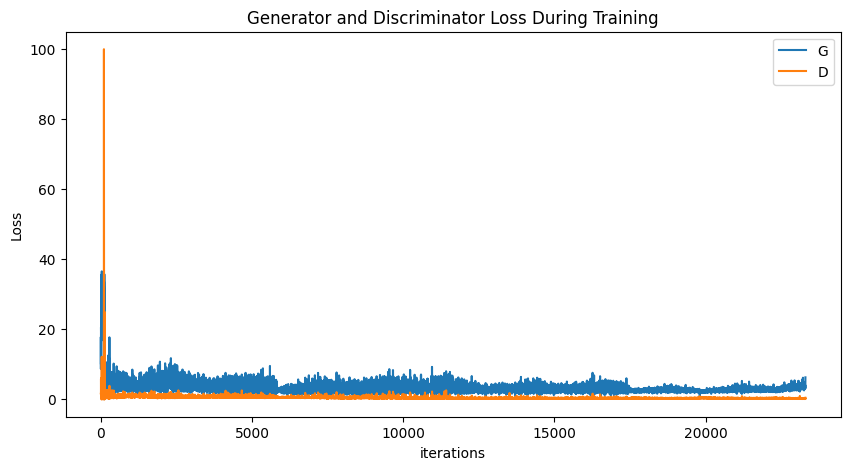

In [184]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

<Figure size 640x480 with 0 Axes>

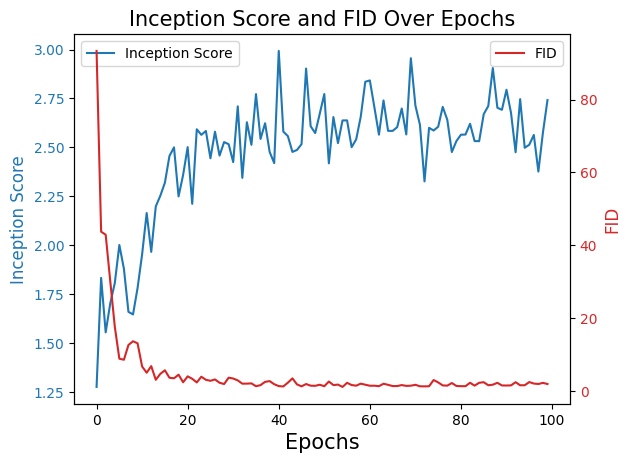

In [185]:


# Create a new figure
plt.figure()

# Plot Inception Score on the left y-axis
fig, ax1 = plt.subplots()

color = 'tab:blue'
ax1.set_xlabel('Epochs', fontsize=15)
ax1.set_ylabel('Inception Score', color=color, fontsize=12)
ax1.plot(is_values, color=color, label='Inception Score')
ax1.tick_params(axis='y', labelcolor=color)

# Create a secondary y-axis for FID
ax2 = ax1.twinx()  # Create a second y-axis sharing the same x-axis
color = 'tab:red'
ax2.set_ylabel('FID', color=color, fontsize=12)  # Set label for FID
ax2.plot(fid_values, color=color, label='FID')
ax2.tick_params(axis='y', labelcolor=color)

# Set legends for both plots
ax1.legend(loc='upper left')  # Inception Score legend
ax2.legend(loc='upper right')  # FID legend

# Show the plot
plt.title('Inception Score and FID Over Epochs', fontsize=15)
plt.show()


MovieWriter imagemagick unavailable; using Pillow instead.
Animation size has reached 21498798 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


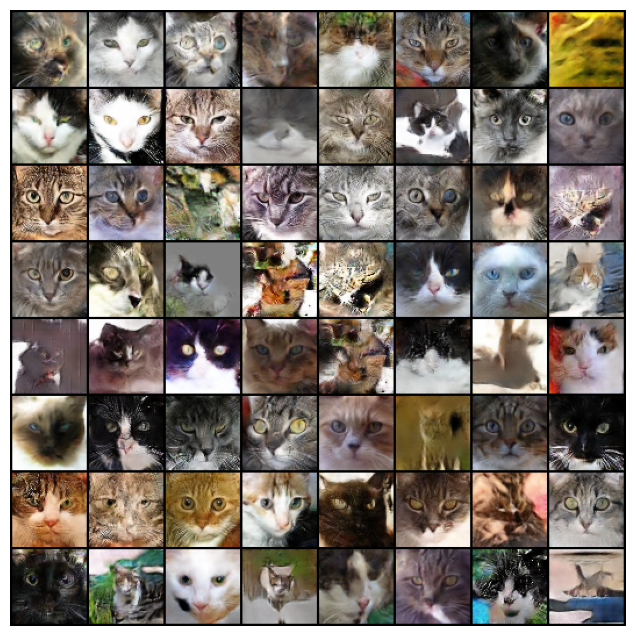

In [186]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
# Save the animation as a GIF
ani.save('animation.gif', writer='imagemagick')  # Use 'imagemagick' writer for GIF format

HTML(ani.to_jshtml())